# Load modules

In [1]:
import scanpy as sc
import scvelo as scv

/data/pinello/SHARED_SOFTWARE/anaconda3/envs/alvin_eris_resvel/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


In [2]:
import numpy as np
import pandas as pd
import loompy
import scanpy as sc
from glob import glob 
import os
import sys
import os
from rpy2.robjects.packages import importr
from rpy2.robjects import r, pandas2ri
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
loompy.__version__
seurat = importr("Seurat")
scv.settings.set_figure_params('scvelo')
scv.settings.verbosity = 3
sc.logging.print_versions()
import pandas as pd
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
from rpy2.robjects import pandas2ri
from rpy2.robjects.conversion import localconverter
pandas2ri.activate()
import matplotlib
print(matplotlib.__version__)
from scanpy.plotting import _utils
from scanpy.plotting._tools.paga import paga
from scanpy.plotting._tools.scatterplots import _get_data_points

from anndata import AnnData

## https://romanhaa.github.io/blog/paga_to_r/
def paga_compare(
    adata: AnnData,
    ax=None,
    basis=None,
    edges=False,
    color=None,
    alpha=None,
    groups=None,
    components=None,
    projection='2d',
    legend_loc='on data',
    legend_fontsize=None,
    legend_fontweight='bold',
    legend_fontoutline=None,
    color_map=None,
    palette=None,
    frameon=False,
    size=None,
    title=None,
    right_margin=None,
    left_margin=0.05,
    show=None,
    save=None,
    title_graph=None,
    groups_graph=None,
    **paga_graph_params,
):
    """\
    Scatter and PAGA graph side-by-side.
    Consists in a scatter plot and the abstracted graph. See
    :func:`~scanpy.pl.paga` for all related parameters.
    See :func:`~scanpy.pl.paga_path` for visualizing gene changes along paths
    through the abstracted graph.
    Additional parameters are as follows.
    Parameters
    ----------
    adata
        Annotated data matrix.
    kwds_scatter
        Keywords for :func:`~scanpy.pl.scatter`.
    kwds_paga
        Keywords for :func:`~scanpy.pl.paga`.
    Returns
    -------
    A list of :class:`~matplotlib.axes.Axes` if `show` is `False`.
    """
    if color is None:
        color = adata.uns['paga']['groups']
    suptitle = None  # common title for entire figure
    if title_graph is None:
        suptitle = color if title is None else title
        title, title_graph = '', ''
    if basis is None:
        if 'X_draw_graph_fa' in adata.obsm.keys():
            basis = 'draw_graph_fa'
        elif 'X_umap' in adata.obsm.keys():
            basis = 'umap'
        elif 'X_tsne' in adata.obsm.keys():
            basis = 'tsne'
        elif 'X_draw_graph_fr' in adata.obsm.keys():
            basis = 'draw_graph_fr'
        else:
            basis = 'umap'

    if 'labels' in paga_graph_params:
        labels = paga_graph_params.pop('labels')
    else:
        labels = groups_graph
    if legend_fontsize is not None:
        paga_graph_params['fontsize'] = legend_fontsize
    if legend_fontweight is not None:
        paga_graph_params['fontweight'] = legend_fontweight
    if legend_fontoutline is not None:
        paga_graph_params['fontoutline'] = legend_fontoutline
    sc.pl.umap(adata, ax=ax, show=False)
#     if 'pos' not in paga_graph_params:
#         if color == adata.uns['paga']['groups']:
#             paga_graph_params['pos'] = _utils._tmp_cluster_pos
#         else:
#             paga_graph_params['pos'] = adata.uns['paga']['pos'] 
    categories = list(adata.obs['clusters'].cat.categories)
    all_pos = np.zeros((len(categories), 2))
    datapoints, components = _get_data_points(adata, 'umap', '2d', 'all', img_key=None, library_id=None)
    for ilabel, label in enumerate(categories):
        _scatter = datapoints[0][adata.obs['clusters'] == label, :]
        x_pos, y_pos = np.median(_scatter, axis=0)
        all_pos[ilabel] = [x_pos, y_pos]  
    paga_graph_params['pos'] = all_pos
    
    paga(
        adata,
        ax=ax,
        show=False,
        save=False,
        title=title_graph,
        labels=labels,
        colors=color,
        frameon=frameon,
        node_size_scale=3, 
        **paga_graph_params,
    )
    _utils.savefig_or_show('paga_compare', show=show, save=save)
    if show == False: return ax

scanpy==1.4.7.dev82+ge1cd0d8 anndata==0.7.1 umap==0.4.4 numpy==1.18.1 scipy==1.4.0rc1 pandas==1.0.3 scikit-learn==0.22 statsmodels==0.10.2 python-igraph==0.8.2 louvain==0.6.1 leidenalg==0.7.0
3.2.0rc1


In [3]:
color_dict = {
    'Ground':  '#773E14',
    'Hypoxia': "#EC8528",
    'UPR':  '#F1FA64',
    'EMT':  '#3B1673',
    'Prolif': '#1440D8',
    'Muscle': '#E12727',
    'Histone': '#E24B8F',
    'Apoptosis': '#9E3CC8', 
    'Interferon': '#489F4B',
    'Unique#6': 'gray',
    'Unique#7': 'gray',
    'Unique#8': 'gray',
    'Unique #5': 'gray',
    'Unique #1': 'gray',
    'Unique #2': 'gray',
    'Unique #3': 'gray',
    'Unique #4': 'gray',
    'Unique #2_4': 'gray',
    'Unique #2_4_6': 'gray',
    'Unique #3_5_Muscle': 'gray',
    'Neural': '#00FFFD'
}

# Fish model

In [5]:
import pandas as pd

In [77]:
# cell line
line_code = pd.read_table('../final_annotations/cellline_annotation.txt', index_col=0)

In [78]:
line_code

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
Sample,,,,,,,,,,,,,,
RD,Ground,Muscle,Ground,EMT,Hypoxia,Prolif,Prolif,Hypoxia,Muscle,Ground,Ground,NaN,NaN,NaN


In [79]:
line_tumor = {
    'RD': sc.read('../results/velocity_dynamical/RD_dynamical_model_velocity.h5ad')
}

In [80]:
meta.head()

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,percent.ribo,lib.size.10k,fraction.mouse,RNA_snn_res.0.4,RNA_snn_res.0.6,RNA_snn_res.0.8,RNA_snn_res.1,RNA_snn_res.1.2,RNA_snn_res.1.4,RNA_snn_res.1.6,RNA_snn_res.1.8,RNA_snn_res.2,seurat_clusters
AAACCCATCTAGTACG,C12SC2,41854.0,6197,2.692694,28.475176,0.714782,0.000476,1,2,1,9,9,9,7,9,8,1
AAACGAAAGCCATATC,C12SC2,35164.0,5455,5.320783,37.353543,0.654792,0.000348,8,12,12,9,9,9,7,9,8,12
AAACGAAAGTGGATTA,C12SC2,20419.0,4248,5.367550,34.712768,0.483145,0.000235,5,4,3,4,3,3,2,3,2,3
AAACGAACAAGACTGG,C12SC2,23220.0,3754,0.938846,49.246339,0.521400,0.000734,0,0,0,0,0,0,1,2,1,0
AAACGAACACTACTTT,C12SC2,35043.0,4573,4.343235,48.486146,0.653627,0.000594,0,0,0,0,0,0,10,0,1,0


RD
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


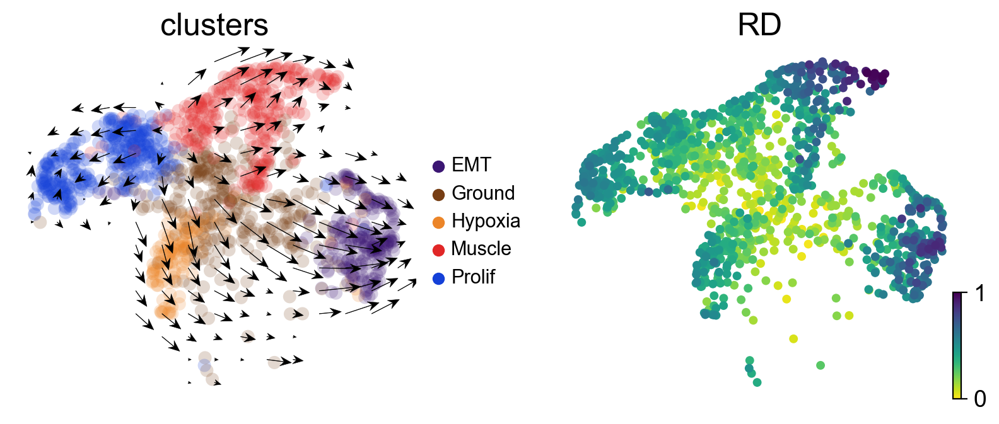

In [81]:
label_stat = {}
fig, axes = plt.subplots(1, 2)
fig.set_size_inches(8, 3.5)
col = 0
row = 0
degrees = []
adatas = []
labels = []
results = {}
for t in line_tumor:
    if t == 'Tumor22': continue
    tumor = line_tumor[t]
    print(t)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')
    test_seu = r('readRDS')(seurat[0])
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
    selection = np.load(f'../results/velocity_dynamical/{label}_velocity.npy')
    if t == 'RD':
        clusters = meta.loc[selection, 'RNA_snn_res.0.8']
        legend='right'
    else:
        clusters = meta.loc[selection, 'SCT_snn_res.1.8']        
        legend=None
    cluster_dict = line_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]
    
    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False)    
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.06, show=False, density=0.3,
                                   ax=axes.flatten()[0+col], arrow_size=4.6,
                                   color='clusters', legend_loc='right margin',
                                   arrow_color='black',
                                   autoscale=False)
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])
#     scv.pl.umap(tumor, color='myf5', show=False, ax=axes.flatten()[2+col], cmap='Purples')
#     scv.pl.umap(tumor, color='mylpfa', show=False, ax=axes.flatten()[3+col], cmap='Purples')    
    col+=4

for a in axes:
    for ax in [a]:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(18)
plt.subplots_adjust(left=0.02, hspace=0.3, wspace=0.35, top=0.9, bottom=0.1)    

In [84]:
!pwd

/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms


In [82]:
tumor.obs.loc[:, ['latent_time', 'clusters']].to_csv('RD_diff_score.csv')

In [83]:
tumor.obs.loc[:, ['latent_time', 'clusters']].groupby('clusters').mean().to_csv('RD_diff_score_mean.csv')

In [85]:
!head RD_diff_score_mean.csv

clusters,latent_time
EMT,0.5344169046018056
Ground,0.15317063043601667
Hypoxia,0.3758714504827609
Muscle,0.48662220259862293
Prolif,0.35523552865422475


In [21]:
fig.savefig("RD_velocity.pdf")

In [26]:
!pwd

/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms


In [5]:
# Zebrafish
fish_code = pd.read_table('../final_annotations/fish_clusters.txt', index_col=0)

In [6]:
fish_code.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
RMS Sample,,,,,,,,,,,,,,,,,
Tumor21,Ground,Ground,Ground,Ground,Prolif,Muscle,Hypoxia,EMT,Ground,EMT,EMT,Ground,Ground,Ground,EMT,Muscle,Ground
Tumor22,UPR,Ground,Ground,Ground,EMT,EMT,Prolif,Prolif,Ground,EMT,Ground,Ground,Muscle,UPR,Muscle,EMT,Hypoxia
Tumor24,EMT,Ground,Ground,Ground,Hypoxia,Ground,EMT,Muscle,Hypoxia,Prolif,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
fish_tumor = {
    'Tumor24': sc.read('../results/velocity_dynamical/Tumor24_velocity.h5ad'), 
    'Tumor22': sc.read('../results/velocity_dynamical/Tumor22_velocity.h5ad'),  
    'Tumor21': sc.read('../results/velocity_dynamical/Tumor21_velocity.h5ad')        
}

In [6]:
# fish_tumor = {
#     'Tumor24': sc.read('../results/velocity_previousversion/Tumor24_velocity.h5ad'),
#     'Tumor22': sc.read('../results/velocity_previousversion/Tumor22_velocity.h5ad'),
#     'Tumor21': sc.read('../results/velocity_previousversion/Tumor21_velocity.h5ad')
# }

Tumor24
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
Tumor21
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


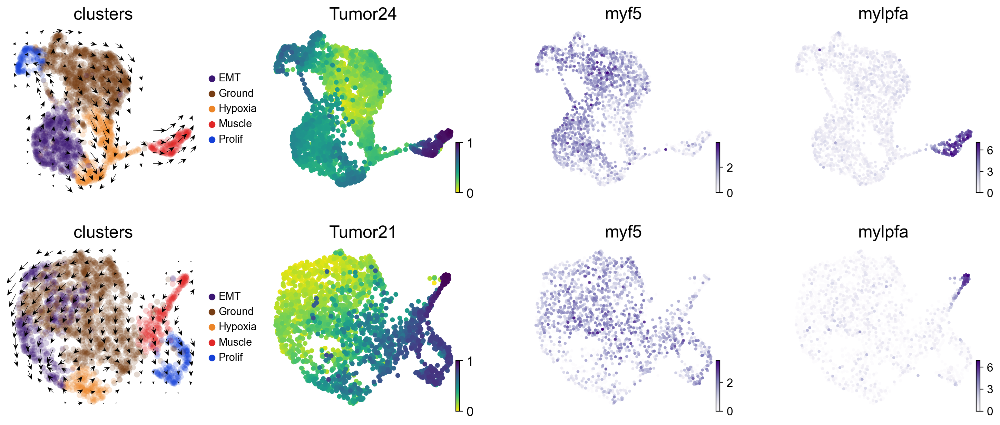

In [13]:
label_stat = {}

# sns.set('paper')
# sns.set_style('white')
fig, axes = plt.subplots(2, 4)
fig.set_size_inches(15, 7)
col = 0
row = 0
degrees = []
adatas = []
labels = []
results = {}
for t in fish_tumor:
    if t == 'Tumor22': continue
    tumor = fish_tumor[t]
    print(t)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')
    test_seu = r('readRDS')(seurat[0])
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
    selection = np.load(f'../results/velocity_dynamical/{label}_velocity.npy')
    if t == 'Tumor24':
        clusters = meta.loc[selection, 'SCT_snn_res.0.8']
        legend='right'
    else:
        clusters = meta.loc[selection, 'SCT_snn_res.1.8']        
        legend=None
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)    
    cluster_dict = fish_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]
    
    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False)    
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.06, show=False, density=0.3,
                                   ax=axes.flatten()[0+col], arrow_size=4.6,
                                   color='clusters', legend_loc='right margin',
                                   arrow_color='black',
                                   autoscale=False)
#     scv.pl.velocity_embedding_stream(tumor, show=False,
#                                      ax=axes.flatten()[0+col], 
#                                      color='clusters', legend_loc=legend)
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])

#    sc.pl.paga(tumor, ax=axes.flatten()[1+col], show=False, 
#               color='clusters')
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=25, frameon=False, show=False,
#                  ax=axes.flatten()[2+col])

    scv.pl.umap(tumor, color='myf5', show=False, ax=axes.flatten()[2+col], cmap='Purples')
    scv.pl.umap(tumor, color='mylpfa', show=False, ax=axes.flatten()[3+col], cmap='Purples')
    
    col+=4

for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(18)
plt.subplots_adjust(left=0.02, hspace=0.3, wspace=0.35, top=0.9, bottom=0.1)    

In [12]:
!pwd

/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms


In [11]:
fig.savefig('Supp3_zebrafish_rms.pdf')

Tumor22
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


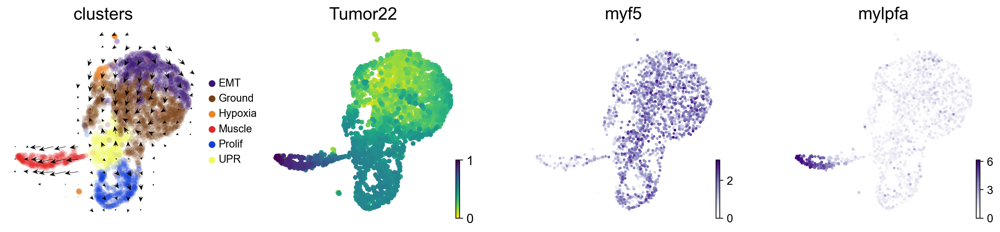

In [17]:
# sns.set('paper')
# sns.set_style('white')
label_stat = {}
fig, axes = plt.subplots(1, 4)
fig.set_size_inches(15, 3.5)
col = 0
row = 0
degrees = []
adatas = []
labels = []
results = {}
for t in fish_tumor:
    if t != 'Tumor22': continue
    tumor = fish_tumor[t]
    print(t)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')
    test_seu = r('readRDS')(seurat[0])
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
    selection = np.load(f'../results/velocity_dynamical/{label}_velocity.npy')
    if t == 'Tumor24':
        clusters = meta.loc[selection, 'SCT_snn_res.0.8']
        legend='right'
    else:
        clusters = meta.loc[selection, 'SCT_snn_res.1.8']        
        legend=None
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)    
    cluster_dict = fish_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]
    
    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False)    
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.06, show=False, density=0.3,
                                   ax=axes.flatten()[0+col], arrow_size=4.6, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)
#     scv.pl.velocity_embedding_stream(tumor, show=False,
#                                      ax=axes.flatten()[0+col], 
#                                      color='clusters', legend_loc=legend)
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0,  ##arrow_color='black',
                   show=False, ax=axes.flatten()[1+col])
#    sc.pl.paga(tumor, ax=axes.flatten()[1+col], show=False, 
#               color='clusters')
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=25, frameon=False, show=False,
#                  ax=axes.flatten()[2+col])

    scv.pl.umap(tumor, color='myf5', show=False, ax=axes.flatten()[2+col], cmap='Purples')
    scv.pl.umap(tumor, color='mylpfa', show=False, ax=axes.flatten()[3+col], cmap='Purples')    
    col+=4
    
for a in axes:
    for ax in [a]:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(18)
plt.subplots_adjust(left=0.02, hspace=0.3, wspace=0.35, top=0.9, bottom=0.1)

In [18]:
!pwd

/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms


In [19]:
fig.savefig('Fig5_zebrafish_rms.pdf')

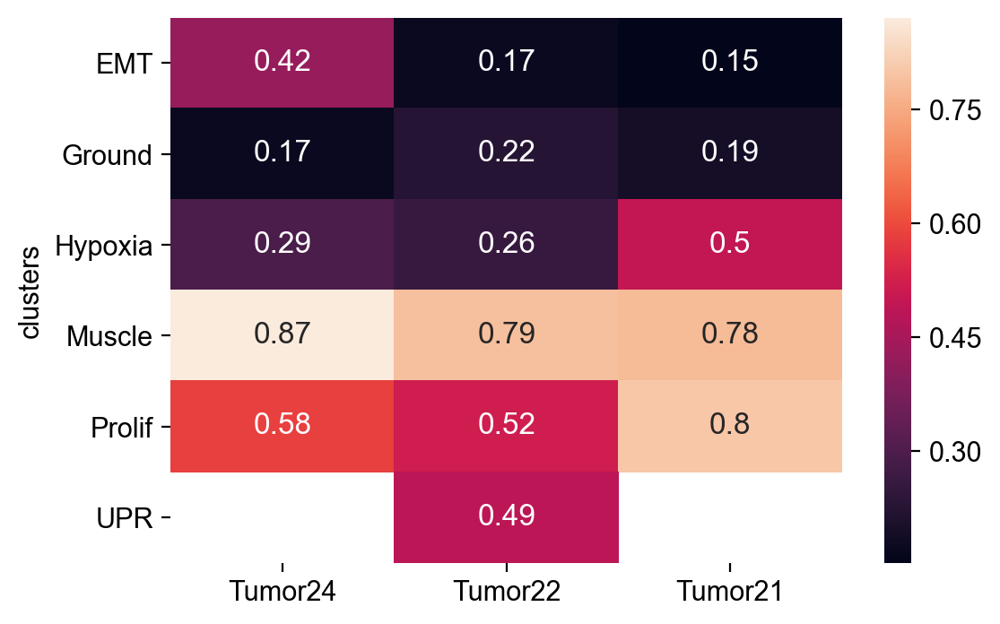

In [20]:
from functools import reduce

fish_lt = []
for t in fish_tumor:
    tumor = fish_tumor[t]
    fish_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').median().latent_time))
fish_lt = reduce(lambda x, y: pd.merge(x, y, left_index=True, right_index=True, how='outer'), fish_lt)  
fish_lt.columns = list(fish_tumor.keys())
import seaborn as sns
sns.heatmap(fish_lt, annot=True)

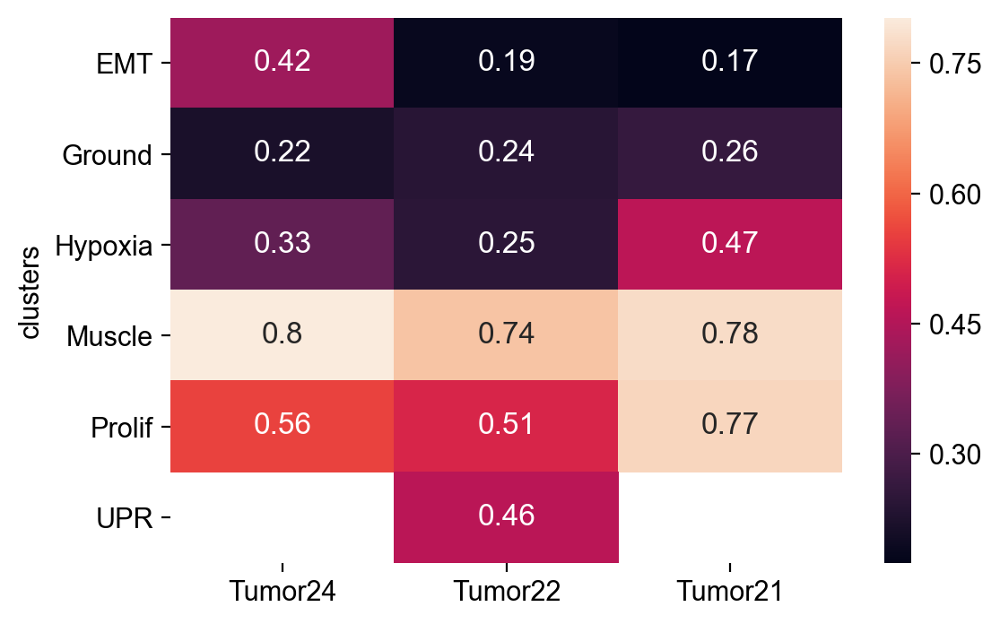

In [21]:
fish_lt = []
for t in fish_tumor:
    tumor = fish_tumor[t]
    fish_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').mean().latent_time))
fish_lt = reduce(lambda x, y: pd.merge(x, y, left_index=True, right_index=True, how='outer'), fish_lt)  
fish_lt.columns = list(fish_tumor.keys())
from functools import reduce
import seaborn as sns
sns.heatmap(fish_lt, annot=True)

In [19]:
fish_lt.to_csv('Zebrafish_average_latent_time.csv')

In [22]:
!pwd

/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms


In [25]:
# results['Tumor24'].groupby('clusters').median().sort_values(['latent_time'], axis=0)

In [27]:
# # sns.set('poster')
# sns.set_style('white')
# fig, ax = plt.subplots(3, 1)
# fig.set_size_inches(6, 18)
# i = 0
# for t in results:
#     order = results[t].groupby('clusters').median().sort_values(['latent_time']).index
#     bplot = sns.boxplot(x='clusters', y='latent_time', data=results[t], 
#                 order=order, width=0.35,
#                 ax=ax[i])
#     print(order)
#     for j in range(0,len(order)):
#         mybox = bplot.artists[j]
#         mybox.set_facecolor(color_dict[order[j]])
#     sns.despine()
#     ax[i].set_xticklabels(order,
#                           rotation=40, ha='right')
#     ax[i].set_title(t)
#     i += 1
# fig

In [12]:
fig.savefig('Fig5_zebrafish_rms_boxplot.pdf')

In [ ]:
# fish_tumor = {
#     'Tumor24': sc.read('../results/velocity_steady/Tumor24_velocity.h5ad'), 
#     'Tumor22': sc.read('../results/velocity_steady/Tumor22_velocity.h5ad'),  
#     'Tumor21': sc.read('../results/velocity_steady/Tumor21_velocity.h5ad')        
# }

# PDX model

In [8]:
pdx_tumor = {
    'MAST139': sc.read('../results/velocity_dynamical/MAST139_velocity.h5ad'),
    'MAST111': sc.read('../results/velocity_dynamical/MAST111_velocity.h5ad'),
    'MAST35': sc.read('../results/velocity_dynamical/MAST35_velocity.h5ad'),   
    'MAST39': sc.read('../results/velocity_dynamical/MAST39_velocity.h5ad'),    
    'MAST85': sc.read('../results/velocity_dynamical/MAST85_velocity.h5ad'),    
    'RH74':   sc.read('../results/velocity_dynamical/RH74_velocity.h5ad'),    
    'MSK74711': sc.read('../results/velocity_dynamical/20191031_MSK74711_cellranger_dynamical_model_velocity.h5ad'),
}

In [4]:
pdx_tumor2 = {
    'MAST118': sc.read('../results/velocity_dynamical/MAST118_dynamical_model_velocity.h5ad'),
    'MSK72117': sc.read('../results/velocity_dynamical/20191031_MSK72117tencell_cellranger_dynamical_model_velocity.h5ad'),
    'MAST95': sc.read('../results/velocity_dynamical/MAST95_velocity.h5ad'),
    'MSK82489': sc.read('../results/velocity_dynamical/MSK82489_velocity.h5ad')
}

In [5]:
# human_code = pd.read_table('../final_annotations/Final_clusters.txt', index_col=0)
human_code = pd.read_table('../final_annotations/Final_clusters_NG.txt', index_col=0)

In [6]:
human_code.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
PDX_Sample,,,,,,,,,,,,,,,,
MSK74711,EMT,Ground,Ground,EMT,Prolif,Muscle,Prolif,Ground,Unique #1,Interferon,NaN,NaN,NaN,NaN,NaN,NaN
MSK72117,Ground,Ground,Ground,Neural,Ground,Neural,Neural,Ground,Prolif,Prolif,Muscle,Prolif,Muscle,Neural,Muscle,Prolif
MAST118,Prolif,Muscle,Ground,Ground,Ground,Prolif,Prolif,Prolif,Prolif,Prolif,UPR,EMT,Neural,Apoptosis,NaN,NaN
MAST111,Ground,Hypoxia,EMT,Ground,Prolif,Apoptosis,Prolif,EMT,Muscle,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MAST139,Prolif,Hypoxia,Prolif,EMT,Ground,EMT,Muscle,EMT,Interferon,EMT,NaN,NaN,NaN,NaN,NaN,NaN


MAST111 (1920, 1999)
../results/seurat_intersect_velocity/20190624_seurat-object_MAST111_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MSK74711 (1926, 2000)
../results/seurat_intersect_velocity/20191031_MSK74711_cellranger_vel_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST118 (2832, 1999)
../results/seurat_intersect_velocity/MAST118_vel_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


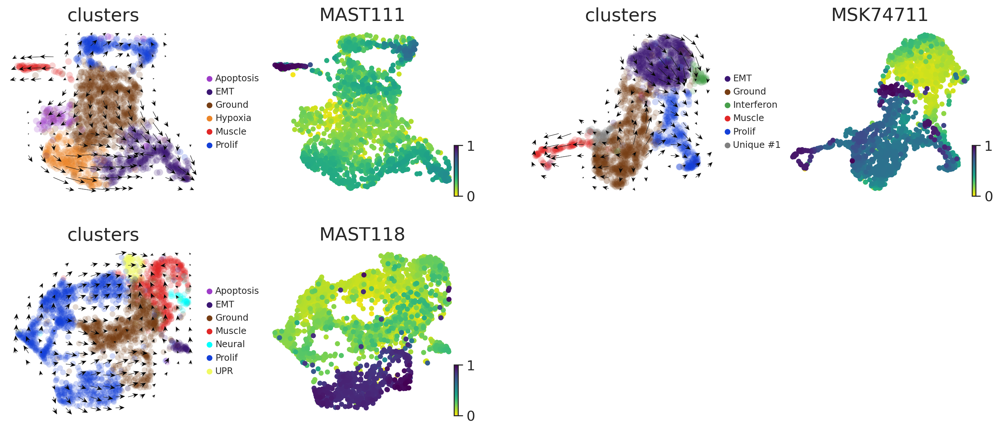

In [9]:
sns.set('paper')
sns.set_style('white')
label_stat = {}
fig, axes = plt.subplots(2, 4)
fig.set_size_inches(14, 6.6)
col = 0
row = 0
degrees = []
adatas = []
results = {}
labels = []
for t in pdx_tumor:
    if not t in ['MAST111', 'MSK74711', 'MAST118']:
        continue
    tumor = pdx_tumor[t]
    print(t, tumor.shape)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    if t=='RH74':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[1]
    else:
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[0]
    if t=='MSK74711':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_vel_seu.rds')[0]
        
    print(seurat)
    test_seu = r('readRDS')(seurat)
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data']) 
    if t!='MSK74711':
        selection = np.load(f'../results/velocity_dynamical/{label}_velocity.npy')
    else:
        selection = np.load('../results/velocity_dynamical/20191031_MSK74711_cellranger_dynamical_model_velocity.npy')
    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)
    cluster_dict = human_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]

    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.05, show=False, density=0.3,
                                   ax=axes.flatten()[0+col], arrow_size=4.2, 
                                   color='clusters', legend_loc='right margin', arrow_color='black',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])    
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=20, frameon=False, show=False,
#                  ax=axes.flatten()[2+col]) 
    col+=2

for t in pdx_tumor2:
    if not t in ['MAST111', 'MSK74711', 'MAST118']:
        continue
    tumor = pdx_tumor2[t]
    print(t, tumor.shape)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    if t=='RH74':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[1]
    else:
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[0]
    if t=='MSK74711':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_vel_seu.rds')[0]
        
    print(seurat)
    test_seu = r('readRDS')(seurat)
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data']) 
        
    if t!='MSK74711':
        selection = np.load(glob(f'../results/velocity_dynamical/*{label}*_*velocity.npy')[0])
    else:
        selection = np.load('../results/velocity_dynamical/20191031_MSK74711_cellranger_dynamical_model_velocity.npy')
        
    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)
    cluster_dict = human_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]

    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.05, show=False, density=0.3,
                                   ax=axes.flatten()[0+col], arrow_size=4.5, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])    
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=20, frameon=False, show=False,
#                  ax=axes.flatten()[2+col]) 
    col+=2
    
for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(18)

ax = axes.flatten()
ax[-1].remove()
ax[-2].remove()
plt.subplots_adjust(left=0.02, hspace=0.3, wspace=0.35, top=0.9, bottom=0.1)

In [17]:
!pwd

/data/langenau/alvin_singlecell/projects/01_sc_rms/phaseA_explore_rms


In [10]:
fig.savefig("Fig5_PDX_velocity.pdf")

Tumor24
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
Tumor21
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST139 (5515, 2000)
../results/seurat_intersect_velocity/20190624_seurat-object_MAST139_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST35 (3480, 1999)
../results/seurat_intersect_velocity/20190624_seurat-object_MAST35_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST39 (9593, 2000)
../results/seurat_intersect_velocity/20190624_seurat-object_MAST39_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:03) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST85 (7094, 2000)
../results/seurat_intersect_velocity/20190624_seurat-object_MAST85_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
RH74 (5131, 2000)
../results/seurat_intersect_velocity/20190624_seurat-object_RH74_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


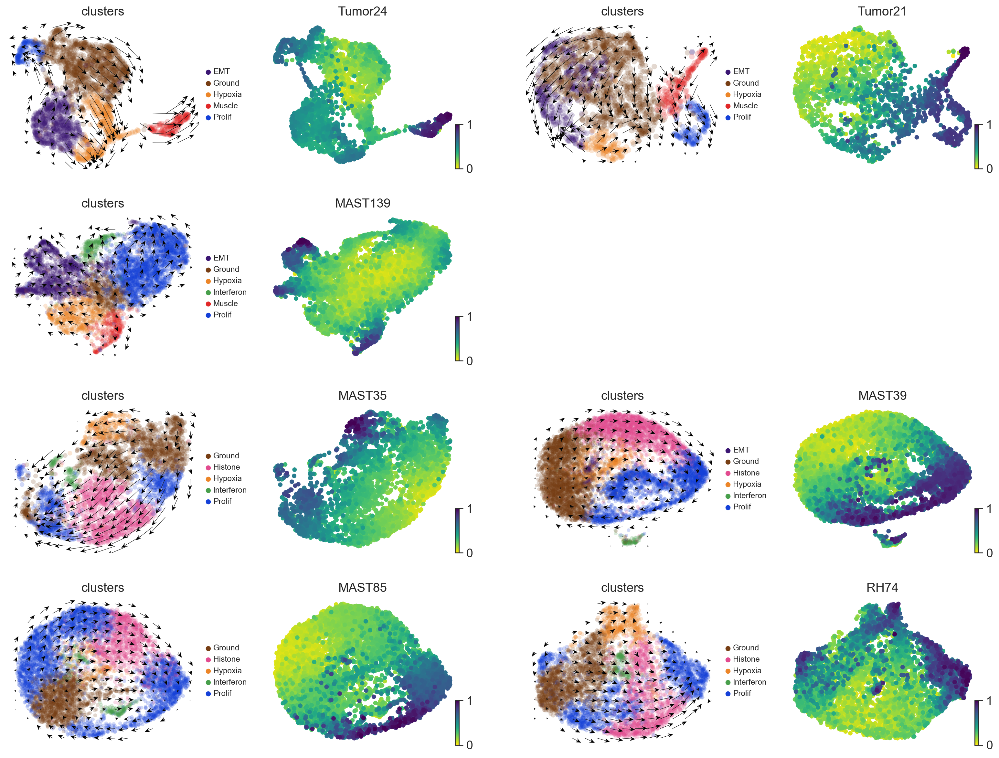

In [36]:
label_stat = {}
fig, axes = plt.subplots(4, 4)
fig.set_size_inches(16, 14)
col = 0
row = 0
degrees = []
adatas = []
results = {}
labels = []

# ax = axes.transpose().flatten()
ax = axes.flatten()

for t in fish_tumor:
    if t == 'Tumor22': continue
    tumor = fish_tumor[t]
    print(t)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')
    test_seu = r('readRDS')(seurat[0])
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
    selection = np.load(f'../results/velocity_dynamical/{label}_velocity.npy')
    if t == 'Tumor24':
        clusters = meta.loc[selection, 'SCT_snn_res.0.8']
        legend='right'
    else:
        clusters = meta.loc[selection, 'SCT_snn_res.1.8']        
        legend=None
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)    
    cluster_dict = fish_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]
    
    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.03, show=False, density=0.3,
                                   ax=ax[0+col], arrow_size=4.2, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0, 
                   show=False, ax=ax[1+col])  
    col += 2

for t in pdx_tumor:    
    if t in ['MAST111', 'MSK74711', 'MAST118']:
        continue
    tumor = pdx_tumor[t]
    print(t, tumor.shape)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    if t=='RH74':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[1]
    else:
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[0]
    if t=='MSK74711':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_vel_seu.rds')[0]
        
    print(seurat)
    test_seu = r('readRDS')(seurat)
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data']) 
    if t!='MSK74711':
        selection = np.load(f'../results/velocity_dynamical/{label}_velocity.npy')
    else:
        selection = np.load('../results/velocity_dynamical/20191031_MSK74711_cellranger_dynamical_model_velocity.npy')
    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)
    cluster_dict = human_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]

    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.03, show=False, density=0.3,
                                   ax=ax[0+col], arrow_size=4.2, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0, 
                   show=False, ax=ax[1+col]) 
    if t!='MAST139':
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=20, frameon=False, show=False,
#                  ax=axes.flatten()[2+col]) 
        col+=2
    else:
        col+=4

    
        
for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(14)
ax = axes.flatten()
ax[6].remove()
ax[7].remove()    
plt.subplots_adjust(left=0.02, hspace=0.3, wspace=0.35, top=0.9, bottom=0.1)

In [37]:
fig.savefig('Supp3_ERMS_PDX_velocity.pdf')

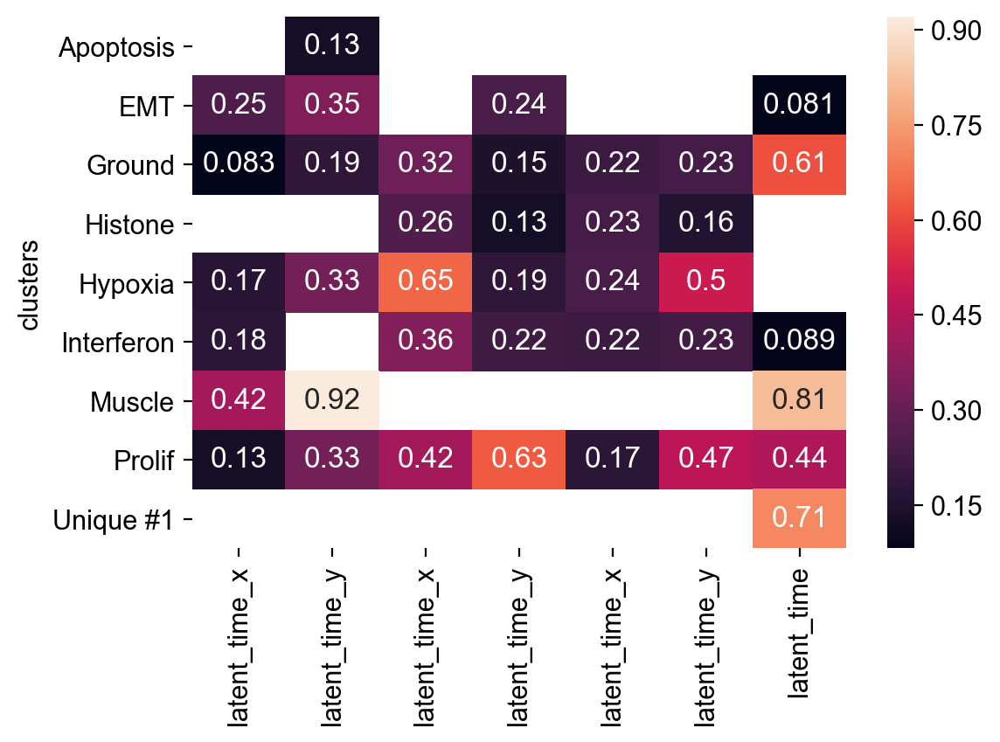

In [51]:
pdx_lt = []
for t in pdx_tumor:
    tumor = pdx_tumor[t]
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').median().latent_time))
pdx_lt = reduce(lambda x, y: pd.merge(x, y, left_index=True, right_index=True, how='outer'), pdx_lt)  
pdx_lt.columns = list(pdx_lt.keys())
from functools import reduce
import seaborn as sns
sns.heatmap(pdx_lt, annot=True)

CategoricalIndex(['Ground', 'Prolif', 'Hypoxia', 'Interferon', 'EMT',
                  'Muscle'],
                 categories=['EMT', 'Ground', 'Hypoxia', 'Interferon', 'Muscle', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Apoptosis', 'Ground', 'Prolif', 'Hypoxia', 'EMT', 'Muscle'], categories=['Apoptosis', 'EMT', 'Ground', 'Hypoxia', 'Muscle', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Histone', 'Ground', 'Interferon', 'Prolif', 'Hypoxia'], categories=['Ground', 'Histone', 'Hypoxia', 'Interferon', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Histone', 'Ground', 'Hypoxia', 'Interferon', 'EMT',
                  'Prolif'],
                 categories=['EMT', 'Ground', 'Histone', 'Hypoxia', 'Interferon', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Prolif', 'Ground', 'Interferon', 'Histone', 'Hypoxia'], categories=['Ground', 'Histone', 'Hypoxia',

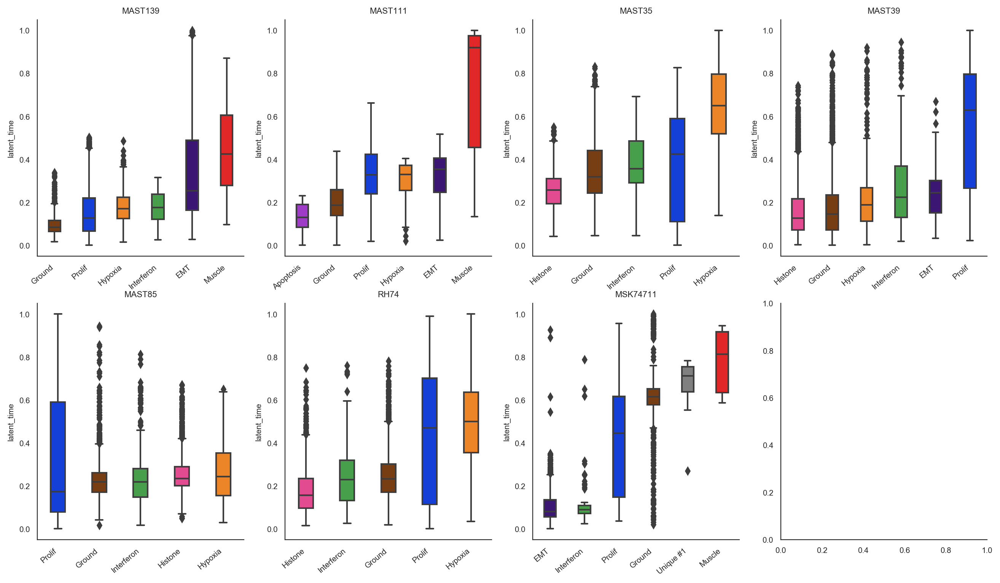

In [24]:
sns.set_style('white')
fig, ax = plt.subplots(2, 4)
fig.set_size_inches(16, 9)
ax = ax.flatten()
i = 0
for t in results:
    order = results[t].groupby('clusters').median().sort_values(['latent_time']).index
    bplot = sns.boxplot(x='clusters', y='latent_time', data=results[t], 
                order=order, width=0.35,
                ax=ax[i])
    print(order)
    for j in range(0,len(order)):
        mybox = bplot.artists[j]
        mybox.set_facecolor(color_dict[order[j]])
    sns.despine()
    ax[i].set_xticklabels(order,
                          rotation=40, ha='right')
    ax[i].set_title(t)
    ax[i].set_xlabel('')
    i += 1
fig

In [ ]:
fig.savefig('Fig5_ERMS_PDX_velocity_box.pdf')

In [11]:
pdx_1cell = {
#    'MAST139-1': sc.read('../results/velocity_dynamical/MAST139_1cells_dynamical_model_velocity.h5ad'),
    'MAST139-1': sc.read('../results/velocity_dynamical/MAST139_1cells_velocity.h5ad'),
#     'RH74-10': sc.read('../results/velocity_dynamical/RH74-10cells_dynamical_model_velocity.h5ad'),
    'MSK72117-1': sc.read('../results/velocity_dynamical/MSK72117-1_velocity.h5ad'),    
    'MAST85-1': sc.read('../results/velocity_dynamical/MAST85-1cell_dynamical_model_velocity.h5ad')
}

In [90]:
mast139_embed = pd.read_csv("/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms/mast139_sc_bulk_embed.csv")

In [104]:
mast139_embed.index = mast139_embed.apply(lambda x: x[1]+x[0].split('_')[0], axis=1)

In [105]:
mast139_embed.head()

,Unnamed: 0,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,percent.ribo,lib.size.10k,fraction.mouse,RNA_snn_res.0.4,RNA_snn_res.0.6,...,RNA_snn_res.1.4,RNA_snn_res.1.6,RNA_snn_res.1.8,RNA_snn_res.2,seurat_clusters,counts.human,fraction.human,counts.mouse,UMAP_1,UMAP_2
MAST139-1cellAAACCCACACAATGTC,AAACCCACACAATGTC_1,MAST139-1cell,33850,5234,7.193501,35.737075,0.641970,0.001257,2,6,...,3,2,15,18,Muscle,NaN,NaN,NaN,-1.117412,5.832520
MAST139-1cellAAACCCACACACAGCC,AAACCCACACACAGCC_1,MAST139-1cell,17508,3786,2.832991,43.465844,0.439459,0.000971,2,6,...,3,2,5,4,Muscle,NaN,NaN,NaN,-0.530285,3.660842
MAST139-1cellAAACCCACACGCCAGT,AAACCCACACGCCAGT_1,MAST139-1cell,43946,5820,3.659036,35.500387,0.731959,0.000926,4,3,...,7,6,6,8,Prolif,NaN,NaN,NaN,-3.930980,-5.104097
MAST139-1cellAAACCCACAGAGTCAG,AAACCCACAGAGTCAG_1,MAST139-1cell,13229,2758,3.137047,48.688487,0.366031,0.000948,0,1,...,11,13,12,12,Ground,NaN,NaN,NaN,2.576621,-1.202183
MAST139-1cellAAACCCATCATTGTTC,AAACCCATCATTGTTC_1,MAST139-1cell,27518,5063,4.738716,37.666255,0.574240,0.001178,0,1,...,2,0,1,3,Ground,NaN,NaN,NaN,2.126941,-0.140426


In [106]:
mast1391= pdx_1cell['MAST139-1'].obs_names.map(lambda x: 'MAST139-1cell'+x.split(':')[1].replace('x', ''))

In [116]:
mast139 = pdx_tumor['MAST139'].obs_names.map(lambda x: 'MAST139'+x.split(':')[1].replace('x', ''))

In [112]:
pdx_1cell['MAST139-1'].obsm['X_umap'] = mast139_embed.loc[mast1391, ['UMAP_1', 'UMAP_2']].values

pdx_tumor['MAST139'].obsm['X_umap'] = mast139_embed.loc[mast139, ['UMAP_1', 'UMAP_2']].values

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


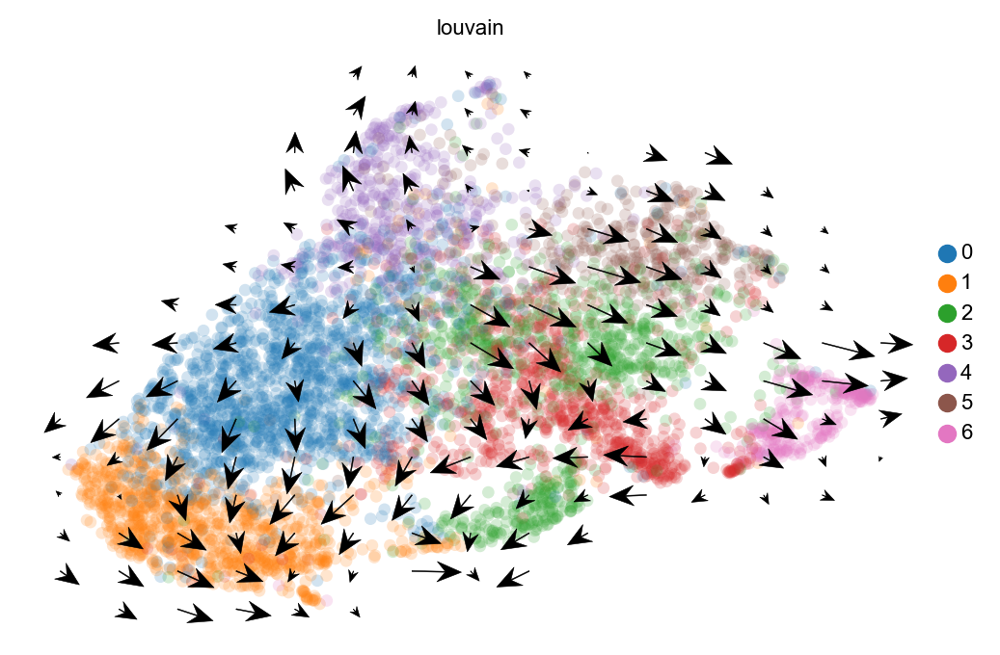

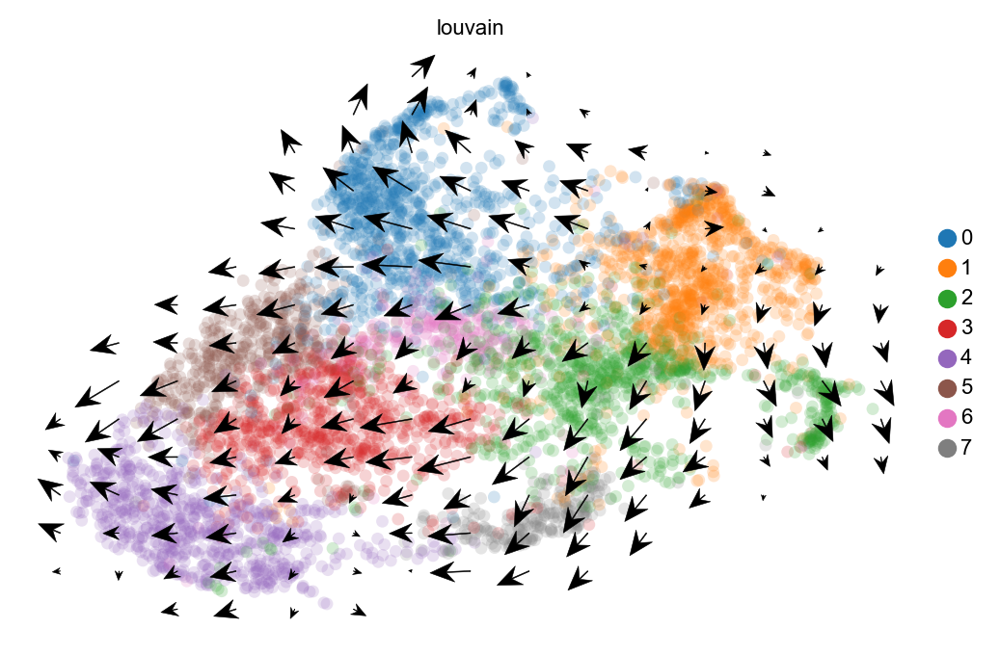

In [123]:
scv.tl.velocity_embedding(pdx_tumor['MAST139'])
scv.pl.velocity_embedding_grid(pdx_tumor['MAST139'], scale=0.03, show=False, density=0.3,
                               legend_fontsize=8, fontsize=8, 
                               arrow_size=4.5, arrow_color='black', #color='clusters', 
                               legend_loc='right margin',
                               autoscale=False)  

scv.tl.velocity_embedding(pdx_1cell['MAST139-1'])
scv.pl.velocity_embedding_grid(pdx_1cell['MAST139-1'], scale=0.03, show=False, density=0.3,
                               legend_fontsize=8, fontsize=8, 
                               arrow_size=4.5, arrow_color='black', #color='clusters', 
                               legend_loc='right margin',
                               autoscale=False)  

In [13]:
pdx_int = {'MAST139-1': pdx_1cell['MAST139-1'], 
           'MAST139': pdx_tumor['MAST139']}

MAST139_1
../results/seurat_intersect_velocity/MAST139_1cells_vel_seu.rds
../results/velocity_dynamical/MAST139_1cells_velocity.npy
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST139
../results/seurat_intersect_velocity/20190624_seurat-object_MAST139_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


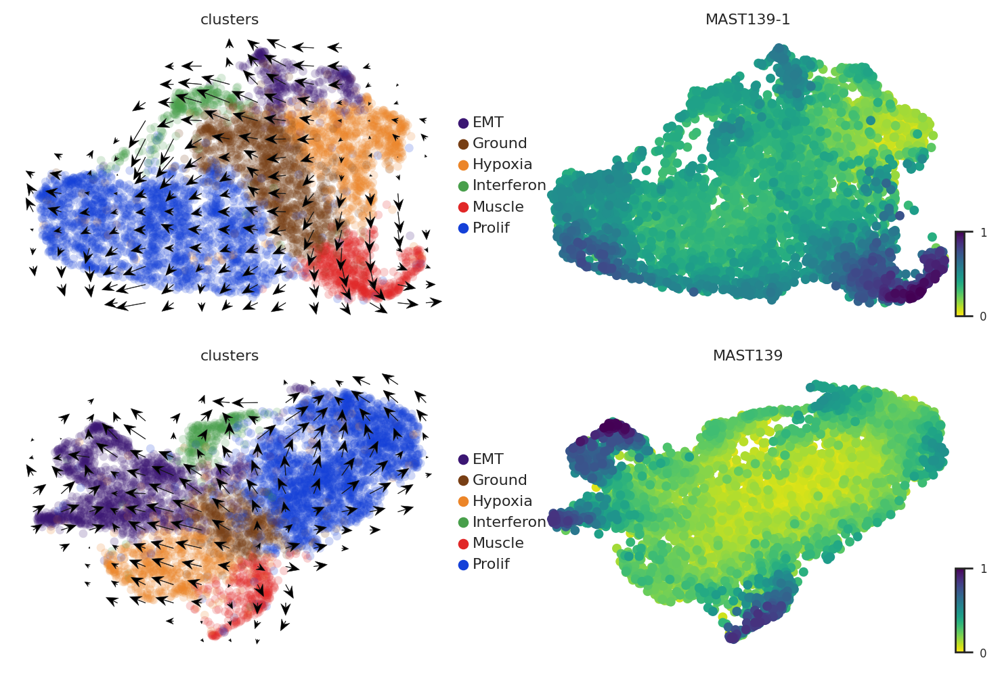

In [14]:
label_stat = {}
fig, axes = plt.subplots(2, 2)
fig.set_size_inches(9, 6)
col = 0
row = 0
degrees = []
adatas = []
results = {}
labels = []
for t in pdx_int:
    if t == 'MAST85-1': break
    tumor = pdx_int[t]
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    if t!='MSK72117-1':
        label2 = label.replace('-', '_')
        print(label2)
    else:
        label = 'C12SC2'        
        label2 = 'C12SC2'
    if t!='MAST139-1':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[0]
    else:
        seurat = glob(f'../results/seurat_intersect_velocity/*{label2}*_seu.rds')[0]
    print(seurat)
    test_seu = r('readRDS')(seurat)
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data']) 
    if t=='MAST139-1':
        print(glob(f'../results/velocity_dynamical/{label2}*_velocity.npy')[1])
        selection = np.load(glob(f'../results/velocity_dynamical/{label2}*_velocity.npy')[1])
    else:
        if t == 'RH74-10':
            selection = np.load(glob(f'../results/velocity_dynamical/{label}*_velocity.npy')[0])        
        else:
            selection = np.load(glob(f'../results/velocity_dynamical/{label}*_velocity.npy')[0])            

    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)
    cluster_dict = human_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]

    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.03, show=False, density=0.3,
                                   legend_fontsize=8, fontsize=8, 
                                   ax=axes.flatten()[0+col], arrow_size=4.5, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=8, fontsize=8,   
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])    
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=20, frameon=False, show=False,
#                  ax=axes.flatten()[2+col]) 
    tumor.obs.loc[:, ['latent_time', 'clusters']].to_csv(f'{label2}_diff_score.csv')
    tumor.obs.loc[:, ['latent_time', 'clusters']].groupby('clusters').mean().to_csv(f'{label2}_diff_score_average.csv')    
    col+=2

for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(8)

In [132]:
fig.savefig("MAST139_SC_bulk_sep_embed_velocity.pdf")

In [133]:
!pwd

/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms


MAST139_1
../results/seurat_intersect_velocity/MAST139_1cells_vel_seu.rds
../results/velocity_dynamical/MAST139_1cells_velocity.npy
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST139
../results/seurat_intersect_velocity/20190624_seurat-object_MAST139_seu.rds
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


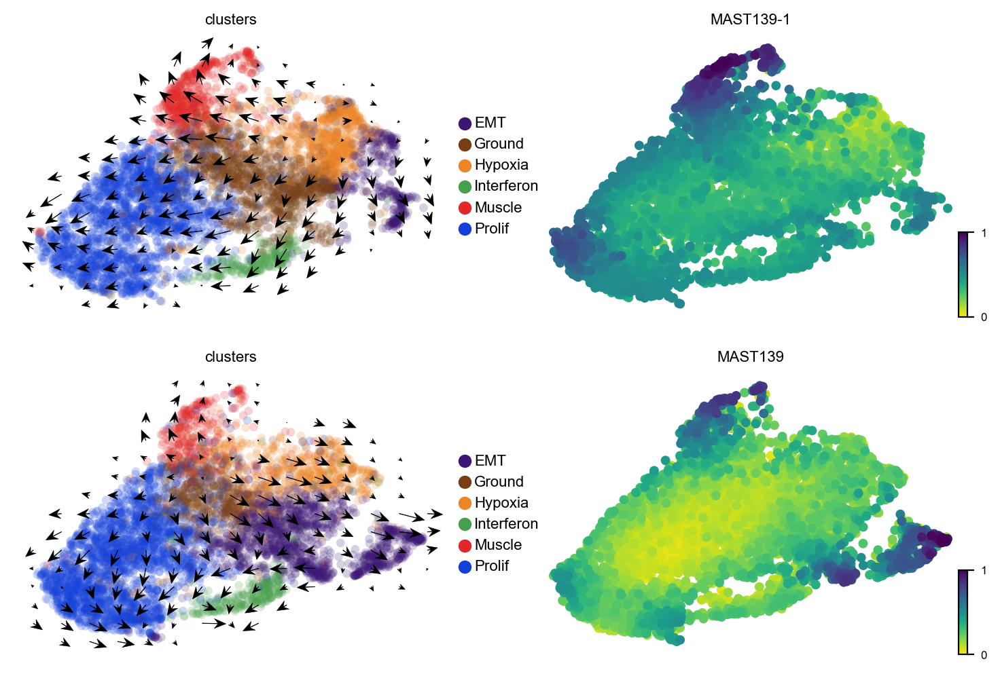

In [128]:
pdx_int['MAST139-1'].obsm['X_umap'] = mast139_embed.loc[mast1391, ['UMAP_1', 'UMAP_2']].values
pdx_int['MAST139'].obsm['X_umap'] = mast139_embed.loc[mast139, ['UMAP_1', 'UMAP_2']].values
label_stat = {}
fig, axes = plt.subplots(2, 2)
fig.set_size_inches(9, 6)
col = 0
row = 0
degrees = []
adatas = []
results = {}
labels = []
for t in pdx_int:
    if t == 'MAST85-1': break
    tumor = pdx_int[t]
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    if t!='MSK72117-1':
        label2 = label.replace('-', '_')
        print(label2)
    else:
        label = 'C12SC2'        
        label2 = 'C12SC2'
    if t!='MAST139-1':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[0]
    else:
        seurat = glob(f'../results/seurat_intersect_velocity/*{label2}*_seu.rds')[0]
    print(seurat)
    test_seu = r('readRDS')(seurat)
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data']) 
    if t=='MAST139-1':
        print(glob(f'../results/velocity_dynamical/{label2}*_velocity.npy')[1])
        selection = np.load(glob(f'../results/velocity_dynamical/{label2}*_velocity.npy')[1])
    else:
        if t == 'RH74-10':
            selection = np.load(glob(f'../results/velocity_dynamical/{label}*_velocity.npy')[0])        
        else:
            selection = np.load(glob(f'../results/velocity_dynamical/{label}*_velocity.npy')[0])            

    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)
    cluster_dict = human_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]

    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
#     umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
#     tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.03, show=False, density=0.3,
                                   legend_fontsize=8, fontsize=8, 
                                   ax=axes.flatten()[0+col], arrow_size=4.5, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=8, fontsize=8,   
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])    
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=20, frameon=False, show=False,
#                  ax=axes.flatten()[2+col]) 
    tumor.obs.loc[:, ['latent_time', 'clusters']].to_csv(f'{label2}_diff_score.csv')
    tumor.obs.loc[:, ['latent_time', 'clusters']].groupby('clusters').mean().to_csv(f'{label2}_diff_score_average.csv')    
    col+=2

for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(8)

In [129]:
fig.savefig("MAST139_SC_bulk_embed_velocity.pdf")

MAST139_1
../results/seurat_intersect_velocity/MAST139_1cells_vel_seu.rds
../results/velocity_dynamical/MAST139_1cells_velocity.npy
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
../results/seurat_intersect_velocity/C12SC2_seu.rds
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


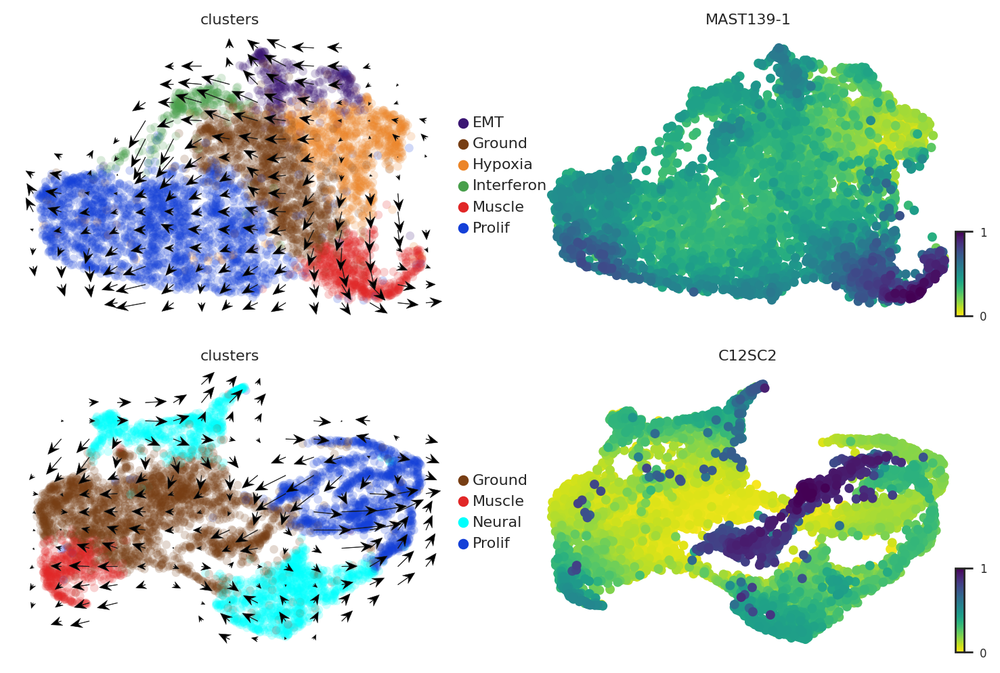

In [15]:
label_stat = {}
fig, axes = plt.subplots(2, 2)
fig.set_size_inches(9, 6)
col = 0
row = 0
degrees = []
adatas = []
results = {}
labels = []
for t in pdx_1cell:
    if t == 'MAST85-1': break
    tumor = pdx_1cell[t]
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    if t!='MSK72117-1':
        label2 = label.replace('-', '_')
        print(label2)
    else:
        label = 'C12SC2'        
        label2 = 'C12SC2'
    if t!='MAST139-1':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[0]
    else:
        seurat = glob(f'../results/seurat_intersect_velocity/*{label2}*_seu.rds')[0]
    print(seurat)
    test_seu = r('readRDS')(seurat)
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data']) 
    if t=='MAST139-1':
        print(glob(f'../results/velocity_dynamical/{label2}*_velocity.npy')[1])
        selection = np.load(glob(f'../results/velocity_dynamical/{label2}*_velocity.npy')[1])
    else:
        if t == 'RH74-10':
            selection = np.load(glob(f'../results/velocity_dynamical/{label}*_velocity.npy')[0])        
        else:
            selection = np.load(glob(f'../results/velocity_dynamical/{label}*_velocity.npy')[0])            

    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)
    cluster_dict = human_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]

    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.03, show=False, density=0.3,
                                   legend_fontsize=8, fontsize=8, 
                                   ax=axes.flatten()[0+col], arrow_size=4.5, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=8, fontsize=8,   
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])    
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=20, frameon=False, show=False,
#                  ax=axes.flatten()[2+col]) 
    tumor.obs.loc[:, ['latent_time', 'clusters']].to_csv(f'{label2}_diff_score.csv')
    tumor.obs.loc[:, ['latent_time', 'clusters']].groupby('clusters').mean().to_csv(f'{label2}_diff_score_average.csv')    
    col+=2

for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(8)

In [16]:
fig.savefig("MAST139_MSK72117_1cell_velocity.pdf")

In [61]:
!pwd

/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms


In [102]:
!du ../results/velocity_dynamical/MAST139_1cells*

932016	../results/velocity_dynamical/MAST139_1cells_dynamical_model_velocity.h5ad
48	../results/velocity_dynamical/MAST139_1cells_dynamical_model_velocity.npy
931008	../results/velocity_dynamical/MAST139_1cells_velocity.h5ad
48	../results/velocity_dynamical/MAST139_1cells_velocity.npy


In [103]:
!du ../results/seurat_intersect_velocity/MAST139_1c*

1120	../results/seurat_intersect_velocity/MAST139_1cells_vel_seu_markers_tumoronly_res0.8.xls
226800	../results/seurat_intersect_velocity/MAST139_1cells_vel_seu.rds
300576	../results/seurat_intersect_velocity/MAST139_1cells_vel_vel.loom
2327264	../results/seurat_intersect_velocity/MAST139_1cells_vel_vel.loom.h5ad
439664	../results/seurat_intersect_velocity/MAST139_1cells_vel_vel.rds


MAST139-1 (5288, 1999)
MAST139_1
../results/seurat_intersect_velocity/MAST139_1cells_vel_seu.rds
../results/velocity_dynamical/MAST139_1cells_velocity.npy
(5578, 17)
(5578,)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
RH74-10 (7391, 1999)
RH74_10
../results/seurat_intersect_velocity/RH74-10cells_vel_seu.rds
(8053, 20)
(8053,)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST85-1 (4333, 2000)
MAST85_1
../results/seurat_intersect_velocity/MAST85-1cell_vel_seu.rds
(4606, 20)
(4606,)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


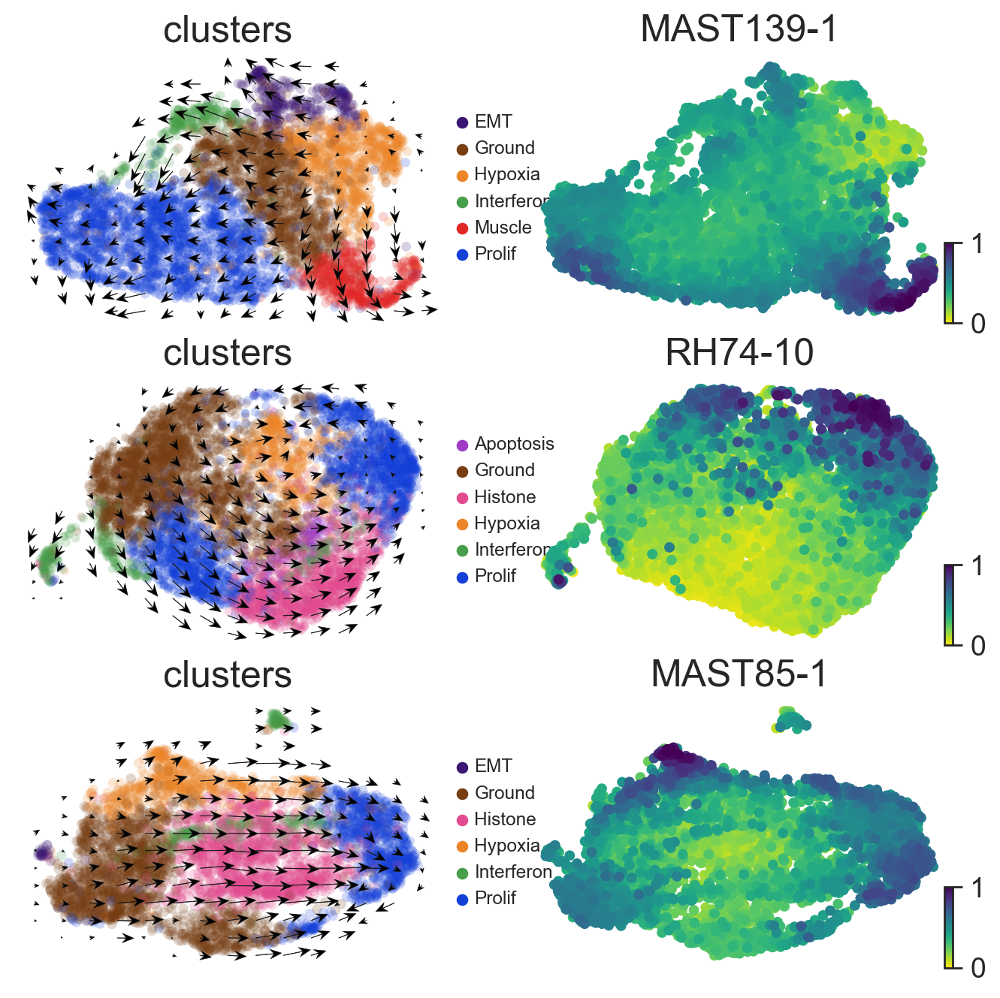

In [41]:
label_stat = {}
fig, axes = plt.subplots(3, 2)
fig.set_size_inches(8, 8)
col = 0
row = 0
degrees = []
adatas = []
results = {}
labels = []
for t in pdx_1cell:
    tumor = pdx_1cell[t]
    print(t, tumor.shape)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    label2 = label.replace('-', '_')
    print(label2)
    if t!='MAST139-1':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_vel_seu.rds')[0]
    else:
        seurat = glob(f'../results/seurat_intersect_velocity/*{label2}*_vel_seu.rds')[0]
    print(seurat)
    test_seu = r('readRDS')(seurat)
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data']) 
    if t=='MAST139-1':
        print(glob(f'../results/velocity_dynamical/{label2}*_velocity.npy')[1])
        selection = np.load(glob(f'../results/velocity_dynamical/{label2}*_velocity.npy')[1])
    else:
        if t == 'RH74-10':
            selection = np.load(glob(f'../results/velocity_dynamical/{label}*_velocity.npy')[0])        
        else:
            selection = np.load(glob(f'../results/velocity_dynamical/{label}*_velocity.npy')[0])            
    print(meta.shape)
    print(selection.shape)
    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)
    cluster_dict = human_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]

    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.03, show=False, density=0.3,
                                   ax=axes.flatten()[0+col], arrow_size=4.5, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])    
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=20, frameon=False, show=False,
#                  ax=axes.flatten()[2+col]) 
    col+=2

for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(18)

In [42]:
fig.savefig('Fig5_PDX_1cell_velocity.pdf')

CategoricalIndex(['Hypoxia', 'Ground', 'Interferon', 'Prolif', 'EMT',
                  'Muscle'],
                 categories=['EMT', 'Ground', 'Hypoxia', 'Interferon', 'Muscle', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Histone', 'Apoptosis', 'Interferon', 'Ground', 'Hypoxia',
                  'Prolif'],
                 categories=['Apoptosis', 'Ground', 'Histone', 'Hypoxia', 'Interferon', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['EMT', 'Prolif', 'Hypoxia', 'Ground', 'Histone',
                  'Interferon'],
                 categories=['EMT', 'Ground', 'Histone', 'Hypoxia', 'Interferon', 'Prolif'], ordered=False, name='clusters', dtype='category')


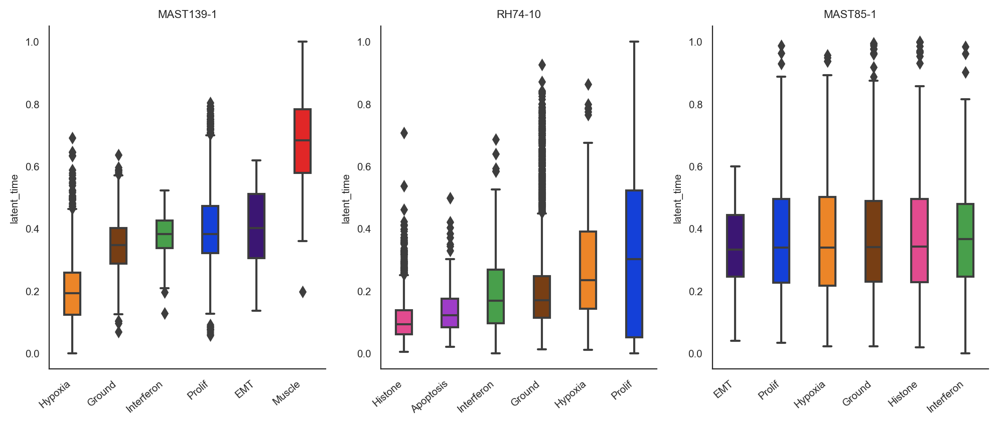

In [32]:
sns.set_style('white')
fig, ax = plt.subplots(1, 3)
fig.set_size_inches(12, 4.5)
ax = ax.flatten()
i = 0
for t in results:
    order = results[t].groupby('clusters').median().sort_values(['latent_time']).index
    bplot = sns.boxplot(x='clusters', y='latent_time', data=results[t], 
                order=order, width=0.35,
                ax=ax[i])
    print(order)
    for j in range(0,len(order)):
        mybox = bplot.artists[j]
        mybox.set_facecolor(color_dict[order[j]])
    sns.despine()
    ax[i].set_xticklabels(order,
                          rotation=40, ha='right')
    ax[i].set_title(t)
    ax[i].set_xlabel('')
    i += 1
fig

In [33]:
fig.savefig('Fig5_PDX_1cell_velocity_box.pdf')

MSK72117 (2477, 1999)
../results/seurat_intersect_velocity/20191031_MSK72117tencell_cellranger_vel_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MAST95 (4235, 1999)
../results/seurat_intersect_velocity/20190624_seurat-object_MAST95_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
MSK82489 (1160, 2000)
../results/seurat_intersect_velocity/20190624_seurat-object_MSK82489_seu.rds


... storing 'sct_variable' as categorical


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


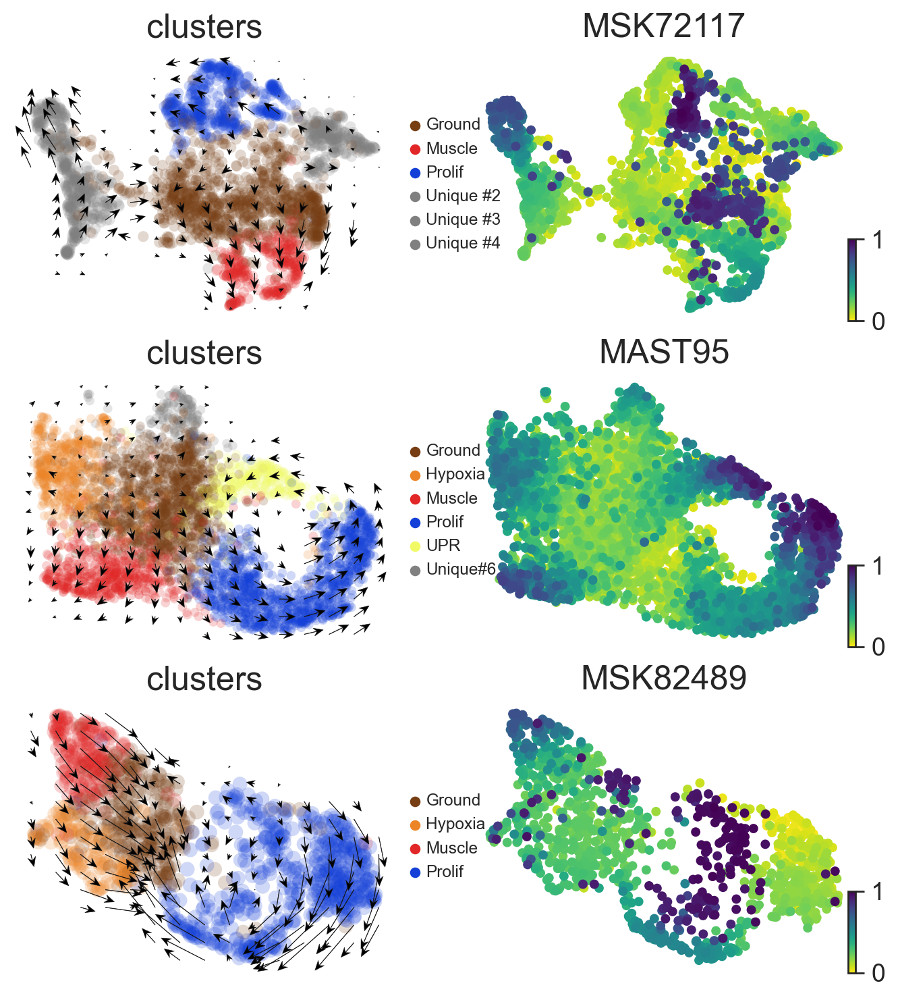

In [43]:
label_stat = {}
fig, axes = plt.subplots(3, 2)
fig.set_size_inches(8, 9)
col = 0
row = 0
degrees = []
adatas = []
results = {}
labels = []
for t in pdx_tumor2:
    if t in ['MAST111', 'MSK74711', 'MAST118']:
        continue
        
    tumor = pdx_tumor2[t]
    print(t, tumor.shape)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    if t=='RH74':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[1]
    else:
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_seu.rds')[0]
    if t=='MSK74711':
        seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_vel_seu.rds')[0]
        
    print(seurat)
    test_seu = r('readRDS')(seurat)
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data']) 
    if t!='MSK74711':
        selection = np.load(glob(f'../results/velocity_dynamical/*{label}*_*velocity.npy')[0])
    else:
        selection = np.load('../results/velocity_dynamical/20191031_MSK74711_cellranger_dynamical_model_velocity.npy')
    clusters = meta.loc[selection, 'RNA_snn_res.0.8']
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)
    cluster_dict = human_code.loc[t, :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]

    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    tumor.obsm['X_umap'] = umap[selection, :]
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False)     
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.05, show=False, density=0.3,
                                   ax=axes.flatten()[0+col], arrow_size=4.2, 
                                   color='clusters', legend_loc='right margin', arrow_color='black',
                                   autoscale=False)  
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,        
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col])    
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=20, frameon=False, show=False,
#                  ax=axes.flatten()[2+col]) 
    col+=2

for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(18)

In [44]:
fig.savefig('Supp3_ARMS_PDX_velocity.pdf')

## Primary patient

CategoricalIndex(['Apoptosis', 'Muscle', 'Ground', 'UPR', 'Unique #5',
                  'Prolif', 'EMT'],
                 categories=['Apoptosis', 'EMT', 'Ground', 'Muscle', 'Prolif', 'UPR', 'Unique #5'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Ground', 'Prolif', 'Unique #3', 'Unique #2', 'Muscle',
                  'Unique #4'],
                 categories=['Ground', 'Muscle', 'Prolif', 'Unique #2', 'Unique #3', 'Unique #4'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Ground', 'Muscle', 'Unique#6', 'Hypoxia', 'Prolif', 'UPR'], categories=['Ground', 'Hypoxia', 'Muscle', 'Prolif', 'UPR', 'Unique#6'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Prolif', 'Ground', 'Hypoxia', 'Muscle'], categories=['Ground', 'Hypoxia', 'Muscle', 'Prolif'], ordered=False, name='clusters', dtype='category')


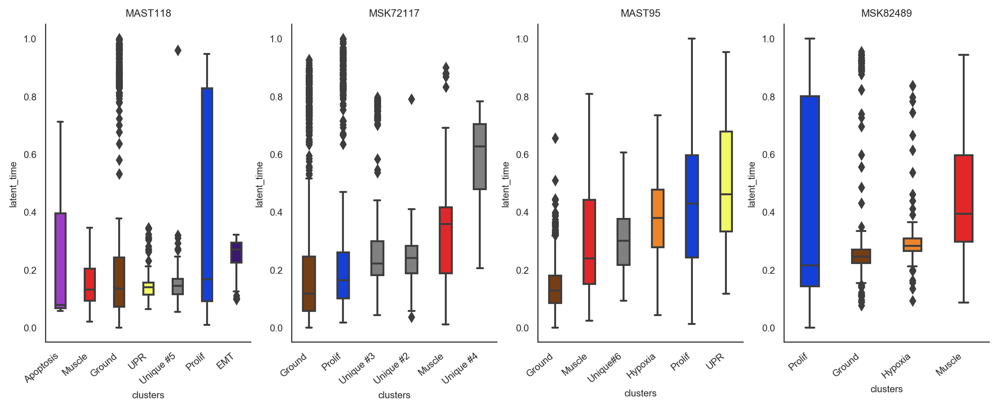

In [38]:
sns.set_style('white')
fig, ax = plt.subplots(1, 4)
fig.set_size_inches(13, 4.5)
ax = ax.flatten()
i = 0
for t in results:
    order = results[t].groupby('clusters').median().sort_values(['latent_time']).index
    bplot = sns.boxplot(x='clusters', y='latent_time', data=results[t], 
                order=order, width=0.35,
                ax=ax[i])
    print(order)
    for j in range(0,len(order)):
        mybox = bplot.artists[j]
        mybox.set_facecolor(color_dict[order[j]])
    sns.despine()
    ax[i].set_xticklabels(order,
                          rotation=40, ha='right')
    ax[i].set_title(t)
    i += 1
fig

In [39]:
fig.savefig('Fig5_ARMS_PDX_velocity_box.pdf')

In [48]:
#pdx_tumor2 = {
    #'MAST118': sc.read('../results/velocity_steady/MAST118_steady_velocity.h5ad'),
    #'MSK72117': sc.read('../results/velocity_steady/20191031_MSK72117tencell_cellranger_steady_velocity.h5ad'),
    #'MAST95': sc.read('../results/velocity_steady/20190624_seurat-object_MAST95_steady_velocity.h5ad'),
    #'MSK82489': sc.read('../results/velocity_steady/20190624_seurat-object_MSK82489_steady_velocity.h5ad')
#}

In [45]:
primary_tumor = {
    '21202': sc.read('../results/velocity_dynamical/21202_hg19_premrna_dynamical_model_velocity.h5ad'),
    '20696': sc.read('../results/velocity_dynamical/20696_dynamical_model_velocity.h5ad'),
    '29806': sc.read('../results/velocity_dynamical/29806_hg19_premrna_dynamical_model_velocity.h5ad'),
    '20082': sc.read('../results/velocity_dynamical/20082_hg19_premrna_dynamical_model_velocity.h5ad')
}

In [46]:
human_code = pd.read_table('../final_annotations/primary_clusters.txt', index_col=0)

21202 (8487, 1999)
['../results/seurat_intersect_velocity/21202_hg19_premrna_vel_seu.rds']
(11901,)
(11901, 16)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
21202
20696 (688, 2000)
['../results/seurat_intersect_velocity/20696_vel_seu.rds']


... storing 'sct_variable' as categorical


(1675,)
(1675, 16)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
20696
20082 (2058, 1999)
['../results/seurat_intersect_velocity/20082_hg19_premrna_vel_seu.rds']


... storing 'sct_variable' as categorical


(6187,)
(6187, 16)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
20082
29806 (1020, 2000)
['../results/seurat_intersect_velocity/29806_hg19_premrna_vel_seu.rds']


... storing 'sct_variable' as categorical


(9674,)
(9674, 16)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
29806


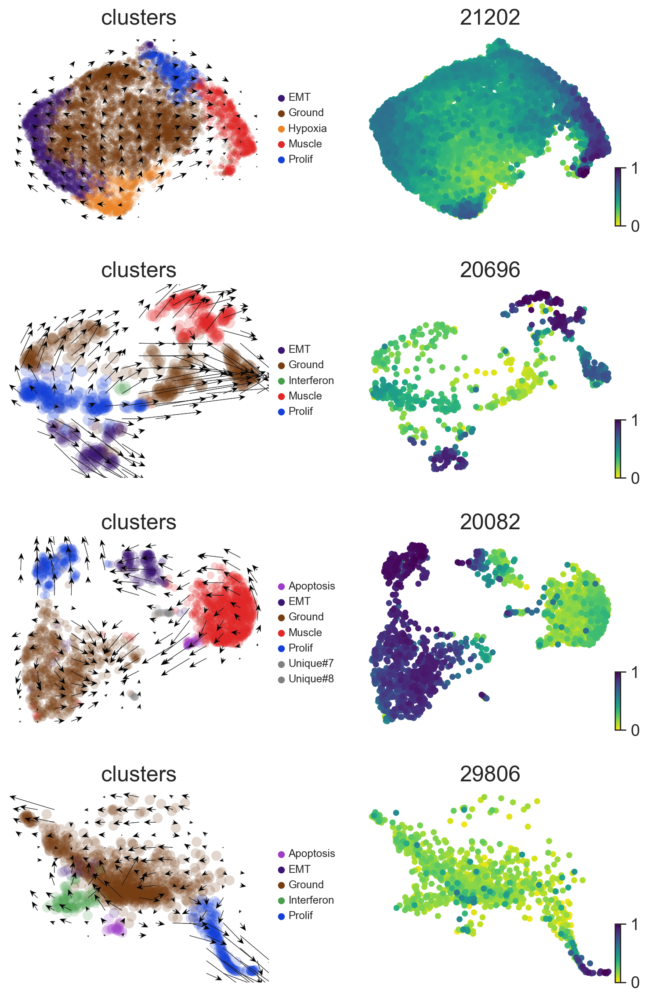

In [48]:
label_stat = {}
fig, axes = plt.subplots(4, 2)
fig.set_size_inches(8, 12)
col = 0
row = 0
degrees = []
adatas = []
labels = []
results = {}
for t in ['21202', '20696', '20082', '29806']:
    tumor = primary_tumor[t]
    print(t, tumor.shape)
    label = os.path.basename(t).split('_')[0]
    labels.append(label)
    seurat = glob(f'../results/seurat_intersect_velocity/*{label}*_vel_seu.rds')
    print(seurat)
    test_seu = r('readRDS')(seurat[0])
    with localconverter(ro.default_converter + pandas2ri.converter):
        meta = ro.conversion.rpy2py(test_seu.slots['meta.data'])    
    sel_file = f'../results/velocity_dynamical/{label}_dynamical_model_velocity.npy'
    selection = np.load(glob(f'../results/velocity_dynamical/*{label}*_*velocity.npy')[0])
    print(selection.shape)
    print(meta.shape)
    if (t == '20082'):
        clusters = meta.loc[selection, 'seurat_clusters']
        scale=0.1
    else:
        clusters = meta.loc[selection, 'seurat_clusters']        
        scale=0.1
    legend='right'
    #clusters.index = clusters.index.map(lambda x: "Tumor24_zebrafish_with_orf_color_v2:%sx" % x)     
    cluster_dict = human_code.loc[int(t), :].dropna().to_dict()
    tumor.obs.loc[:, 'clusters'] = clusters.values.map(cluster_dict).astype('category')
    tumor.uns['clusters_colors'] = [color_dict[c] for c in tumor.obs['clusters'].cat.categories]
    umap = r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')
    
    sc.tl.paga(tumor)    
    sc.tl.paga(tumor, groups='clusters', use_rna_velocity=False) 
    
    tumor.obsm['X_umap'] = umap[selection, :]
    scv.tl.velocity_embedding(tumor)
    scv.pl.velocity_embedding_grid(tumor, scale=0.05, show=False, density=0.3,
                                   ax=axes.flatten()[0+col], arrow_size=4, arrow_color='black',
                                   color='clusters', legend_loc='right margin',
                                   autoscale=False)
    print(label)
    scv.pl.scatter(tumor, basis='umap', color=['latent_time'], title=label,
                   size=100, legend_fontsize=18, fontsize=18,
                   vmin=0, vmax=1.0, 
                   show=False, ax=axes.flatten()[1+col]) 
    axes.flatten()[1+col].set_title(label)
    
    results[t] = pd.concat([tumor.obs.loc[:, 'clusters'], 
                            tumor.obs.loc[:, 'latent_time']], axis=1)    
#     paga_compare(tumor, title='', legend_loc='none', threshold=0.1, 
#                  right_margin=0.2, size=20, edge_width_scale=1, basis='umap',
#                  legend_fontsize=18, frameon=False, show=False,
#                  ax=axes.flatten()[2+col])     
    col+=2
#    break

for a in axes:
    for ax in a:
        for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
                      ax.get_xticklabels() + ax.get_yticklabels()):
            item.set_fontsize(18)
            
plt.subplots_adjust(left=0.03, right=0.90, hspace=0.3, wspace=0.35, top=0.95, bottom=0.05)

In [49]:
fig.savefig('Supp3_primarypatient_velocity.pdf')

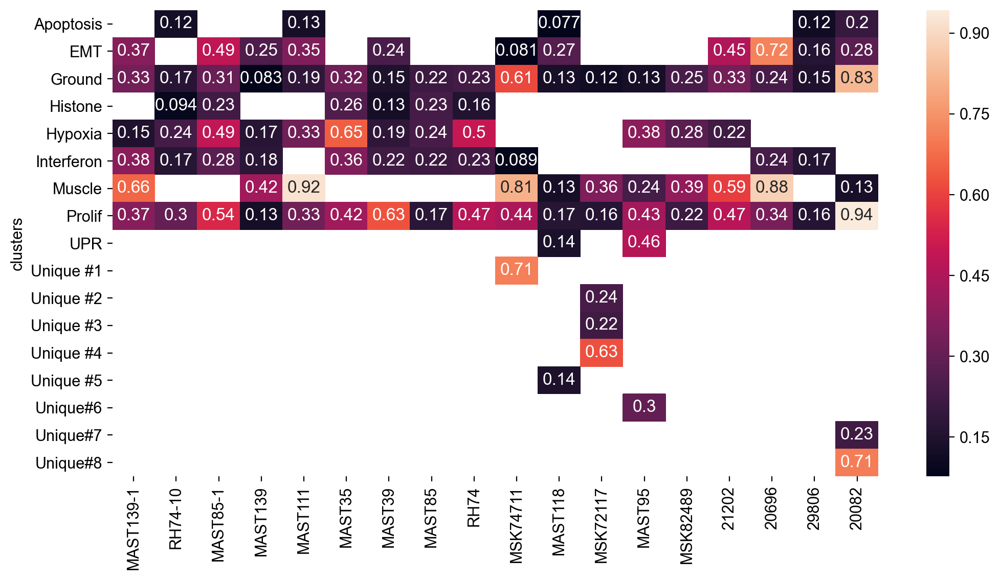

In [103]:
pdx_lt = []
for t in pdx_1cell:
    tumor = pdx_1cell[t] 
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').median().latent_time))    
for t in pdx_tumor:
    tumor = pdx_tumor[t]
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').median().latent_time))
for t in pdx_tumor2:
    tumor = pdx_tumor2[t]
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').median().latent_time))    
for t in primary_tumor:
    tumor = primary_tumor[t]
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').median().latent_time))   
pdx_lt = reduce(lambda x, y: pd.merge(x, y, left_index=True, right_index=True, how='outer'), pdx_lt)  
pdx_lt.columns = list(pdx_1cell.keys()) + list(pdx_tumor.keys()) + list(pdx_tumor2.keys()) + list(primary_tumor.keys())
from functools import reduce
import seaborn as sns
fig, ax = plt.subplots()
fig.set_size_inches(12, 6)
sns.heatmap(pdx_lt, annot=True, ax=ax)

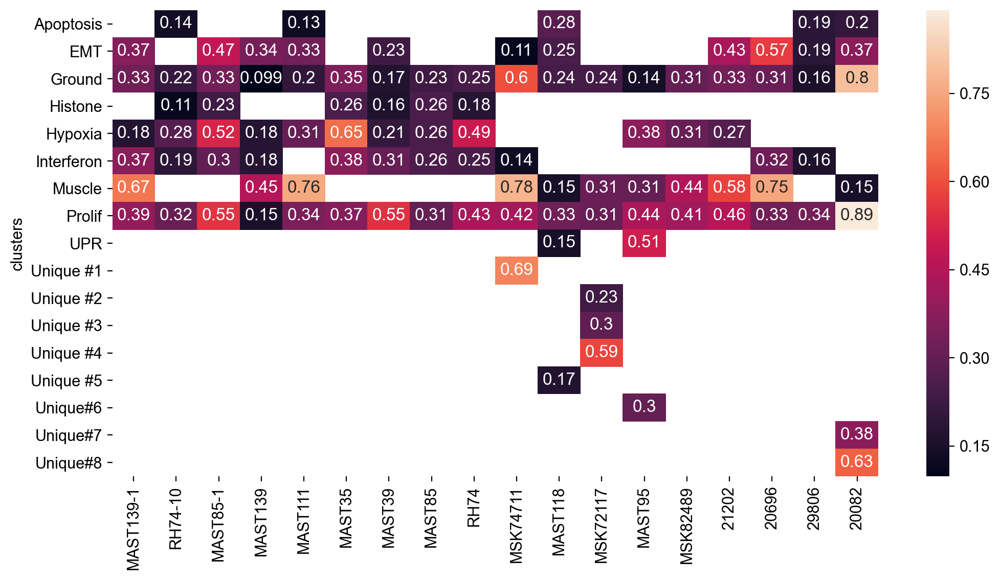

In [104]:
pdx_lt = []
for t in pdx_1cell:
    tumor = pdx_1cell[t] 
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').mean().latent_time))    
for t in pdx_tumor:
    tumor = pdx_tumor[t]
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').mean().latent_time))
for t in pdx_tumor2:
    tumor = pdx_tumor2[t]
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').mean().latent_time))    
for t in primary_tumor:
    tumor = primary_tumor[t]
    pdx_lt.append(pd.DataFrame(tumor.obs.groupby('clusters').mean().latent_time))   
pdx_lt = reduce(lambda x, y: pd.merge(x, y, left_index=True, right_index=True, how='outer'), pdx_lt)  
pdx_lt.columns = list(pdx_1cell.keys()) + list(pdx_tumor.keys()) + list(pdx_tumor2.keys()) + list(primary_tumor.keys())
from functools import reduce
import seaborn as sns
fig, ax = plt.subplots()
fig.set_size_inches(12, 6)
sns.heatmap(pdx_lt, annot=True, ax=ax)

CategoricalIndex(['Hypoxia', 'Ground', 'EMT', 'Prolif', 'Muscle'], categories=['EMT', 'Ground', 'Hypoxia', 'Muscle', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Interferon', 'Ground', 'Prolif', 'EMT', 'Muscle'], categories=['EMT', 'Ground', 'Interferon', 'Muscle', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Apoptosis', 'Ground', 'EMT', 'Prolif', 'Interferon'], categories=['Apoptosis', 'EMT', 'Ground', 'Interferon', 'Prolif'], ordered=False, name='clusters', dtype='category')
CategoricalIndex(['Muscle', 'Apoptosis', 'Unique#7', 'EMT', 'Unique#8',
                  'Ground', 'Prolif'],
                 categories=['Apoptosis', 'EMT', 'Ground', 'Muscle', 'Prolif', 'Unique#7', 'Unique#8'], ordered=False, name='clusters', dtype='category')


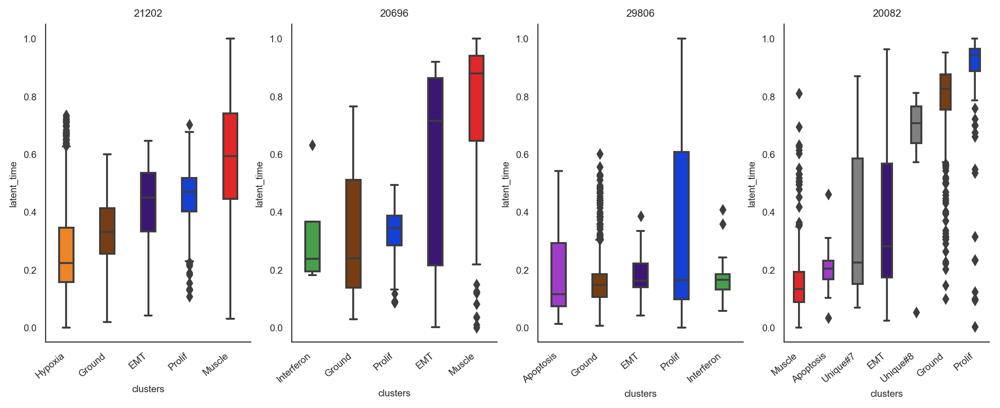

In [50]:
sns.set_style('white')
fig, ax = plt.subplots(1, 4)
fig.set_size_inches(13, 4.5)
ax = ax.flatten()
i = 0
for t in results:
    order = results[t].groupby('clusters').median().sort_values(['latent_time']).index
    bplot = sns.boxplot(x='clusters', y='latent_time', data=results[t], 
                order=order, width=0.35,
                ax=ax[i])
    print(order)
    for j in range(0,len(order)):
        mybox = bplot.artists[j]
        mybox.set_facecolor(color_dict[order[j]])
    sns.despine()
    ax[i].set_xticklabels(order,
                          rotation=40, ha='right')
    ax[i].set_title(t)
    i += 1
fig

In [51]:
fig.savefig('Fig5_primarypatient_velocity_box.pdf')

In [52]:
!pwd

/PHShome/qq06/projects/01_sc_rms/phaseA_explore_rms
